# Multi-Head Attention


##### Multi-head attention is a mechanism used in neural networks, particularly in the Transformer architecture, which is foundational for many state-of-the-art natural language processing models like BERT and GPT. The concept was introduced in the "Attention is All You Need" paper by Vaswani et al. in 2017. Here’s an overview of how it works and why it's useful:

- How Multi-Head Attention Works
>    Attention Mechanism:

-    The attention mechanism allows the model to focus on different parts of the input sequence when producing each output. This is achieved through the computation of attention scores which weigh the importance of each element in the sequence relative to the others.
    
>    Multiple Heads:

-    In multi-head attention, the model uses several attention mechanisms (heads) in parallel. Each head operates independently on the same input but can learn to focus on different parts of the sequence.Each head has its own set of weight matrices for computing the queries (Q), keys (K), and values (V).
    
>   Concatenation and Linear Transformation:

- The outputs from all the heads are concatenated and then linearly transformed. This helps in aggregating different perspectives captured by each head, enhancing the model’s ability to understand context more effectively.
    
>   Detailed Steps:
    
>   Linear Projections:

- The input is linearly projected into different subspaces to produce queries, keys, and values. If there are ℎ heads, the input is split into ℎ parts.
    
>    Scaled Dot-Product Attention:

- Each head performs scaled dot-product attention, which involves: Calculating the dot product of the query and key. Scaling the result by the square root of the dimension of the keys. Applying a softmax function to obtain attention weights. Using these weights to compute a weighted sum of the values.
>    Concatenation:
        
- The outputs of all heads are concatenated.

>    Final Linear Projection:

- This concatenated output is then passed through a final linear layer to produce the output of the multi-head attention module. Why Multi-Head Attention is Useful Parallel Processing: Multiple heads allow the model to process information in parallel, capturing various features and dependencies simultaneously. Diversity in Attention: Different heads can focus on different parts of the input, capturing a wider range of information and dependencies within the sequence. Improved Representation: By combining multiple attention outputs, the model can create richer, more nuanced representations of the input, leading to better performance in tasks such as translation, text generation, and more.


## Import Dependencies


In [1]:
import numpy as np
import torch
from torch import nn
import torch.nn.functional as F

In [2]:
torch.manual_seed(43)   
sequence_length = 4 # number of words in a sentence
batch_size = 1 # parallel processing
input_dimension = 512  # (vector dimension) input of attention unit
d_model = 512  # output of attention unit
x = torch.rand((batch_size, sequence_length, input_dimension))
print(x.shape)
print(x)

torch.Size([1, 4, 512])
tensor([[[0.4540, 0.1965, 0.9210,  ..., 0.7694, 0.7714, 0.8065],
         [0.1012, 0.4330, 0.9259,  ..., 0.1192, 0.7634, 0.0652],
         [0.4206, 0.5615, 0.3670,  ..., 0.1651, 0.4983, 0.8484],
         [0.3419, 0.5971, 0.3873,  ..., 0.1530, 0.8872, 0.9132]]])


In [3]:
# creating query, key, value vector all concatenated in one
query_key_value_layer = nn.Linear(input_dimension, d_model*3)
# passing input to the query, key, value layer
query_key_value = query_key_value_layer(x)
print(query_key_value.shape)
print(query_key_value)

torch.Size([1, 4, 1536])
tensor([[[-0.0481,  0.2675,  0.0800,  ...,  0.5417,  0.4755,  0.0752],
         [-0.5284,  0.3370,  0.1856,  ...,  0.5131,  0.7041,  0.0475],
         [-0.3594,  0.2273,  0.2777,  ..., -0.1070,  0.6801, -0.2746],
         [ 0.0292,  0.3987,  0.0321,  ...,  0.6134,  0.6481,  0.0453]]],
       grad_fn=<ViewBackward0>)


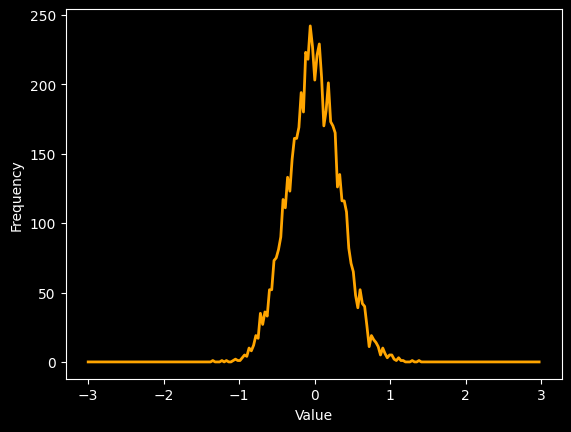

In [4]:
import matplotlib.pyplot as plt
y_plot = torch.histc(query_key_value, bins=200, min=-3, max=3)
x_plot = np.arange(-1, 1, 0.01)*3
plt.style.use('dark_background')
# plt.bar(x_plot,y_plot,align="center",color="orange",edgecolor="black")
plt.plot(x_plot, y_plot, color="orange", linewidth=2)
plt.xlabel("Value")
plt.ylabel("Frequency")
plt.show()

Text(0.5, 0, 'value')

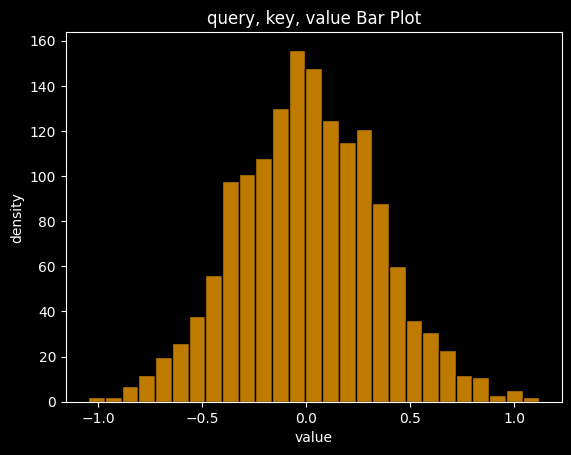

In [5]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.histplot(query_key_value[-1, 1, :].detach().numpy(),
             fill=True, color='Orange', edgecolor='black')
plt.style.use('dark_background')
plt.title("query, key, value Bar Plot")
plt.ylabel("density")
plt.xlabel("value")

In [6]:
atttention_head = 8
head_dimension = d_model//atttention_head
query_key_value = query_key_value.reshape(batch_size, sequence_length, atttention_head, head_dimension*3)
query_key_value.size()

torch.Size([1, 4, 8, 192])

- Number of attention Heads (attention_heads):
  Imagine your attention mechanism as having multiple "heads" or units, each capable of looking at the input data from a different perspective.
  num_heads is the number of these heads. Having more heads allows the model to focus on different aspects of the input simultaneously.
- Head Dimension (head_dimension):

  The total information in your model is represented by d_model. To allow each attention head to focus on a different part of this information, you split it into smaller parts.
  head_dimenssion is the dimension of each of these smaller parts. It's calculated as d_model divided by the number of heads (num_heads).

- Reshaping (qkv.reshape(...)):
  By reshaping, you split the last dimension (d_model) into three parts, each with a size of head_dim. So, the new shape becomes (batch_size, sequence_length, num_heads, 3 \* head_dim).

- Why Multiply by 3:

  Since you're calculating queries, keys, and values for each attention head, and each of these has a dimension of head_dim, you need space for all three. Hence, 3 \* head_dim.


In [7]:
query_key_value = query_key_value.permute(0, 2, 1, 3) # to alter the dimensions of the tensor
query_key_value.size()

torch.Size([1, 8, 4, 192])

In [9]:
query, key, value = query_key_value.chunk(3, dim=-1)
print("Query size: ", query.size())
print("Key size: ", key.size())
print("Value size: ", value.size())

Query size:  torch.Size([1, 8, 4, 64])
Key size:  torch.Size([1, 8, 4, 64])
Value size:  torch.Size([1, 8, 4, 64])


### Self-Attention For Multiple Heads


In [10]:
import math
dim_k = query.size(-1)
# here we have to specify the dimension along which we have to take the transpose , in this case we are taking the transpose of sequence length and head dimension for every word in every head
scaled = torch.matmul(query, key.transpose(2, 3))/math.sqrt(dim_k)
scaled[0][0]
scaled.shape

torch.Size([1, 8, 4, 4])

In [11]:
dim_k = query.size()[3]
dim_k

64

#### Masked Multi-Head Attention


In [12]:
mask = torch.full(scaled.shape, float('-inf'))
mask = torch.triu(mask, diagonal=1)  # from preventing it into looking future words
print(mask[0][1])
print(mask.shape)

tensor([[0., -inf, -inf, -inf],
        [0., 0., -inf, -inf],
        [0., 0., 0., -inf],
        [0., 0., 0., 0.]])
torch.Size([1, 8, 4, 4])


- Why -inf??
  this is because we would be aplying softmax over the scaled vector where the exponets of zero would become 1 and -inf would become 0 # no-cheating


In [13]:
# Applying Mask
scaled += mask
#scaled=scaled+mask
print(scaled[0][0])

tensor([[-0.1453,    -inf,    -inf,    -inf],
        [-0.0737, -0.0674,    -inf,    -inf],
        [-0.1041, -0.1133, -0.0522,    -inf],
        [-0.0431, -0.0317, -0.0293, -0.1062]], grad_fn=<SelectBackward0>)


In [14]:
# Let's apply exponents for some value
np.exp(-0.0737)/(np.exp(-0.0737)+np.exp(-0.0674))

0.4984250052092918

In [17]:
# We chose dimension as -1 so that it gets applier row wise
attention = F.softmax(scaled, dim=-1)
print(attention[0][0])
print(attention.shape)

tensor([[1.0000, 0.0000, 0.0000, 0.0000],
        [0.4984, 0.5016, 0.0000, 0.0000],
        [0.3285, 0.3255, 0.3460, 0.0000],
        [0.2523, 0.2552, 0.2558, 0.2368]], grad_fn=<SelectBackward0>)
torch.Size([1, 8, 4, 4])


In [16]:
# Let's generate the new value as these are going ot be more context aware than orignal value vectors (what i am giving(vector))
values = torch.matmul(attention, value)
values[0][0]
values.shape

torch.Size([1, 8, 4, 64])

In [17]:
values = values.reshape(batch_size, sequence_length,
                        atttention_head*head_dimension)
values.shape

torch.Size([1, 4, 512])

- After reshaping values into a shape of (batch_size, sequence_length, attention_head \* head_dimension), a linear layer is applied. The purpose of using a linear layer here is to introduce additional non-linearity and learnable weights to the model. This is a common practice in neural networks to allow the model to learn complex relationships and representations.


In [18]:
linear_layer = nn.Linear(d_model, d_model)
output = linear_layer(values)
output.shape

torch.Size([1, 4, 512])

### Main Class (Multi-Head-Attention)

In [19]:
import numpy as np
import torch
from torch import nn
import torch.nn.functional as F
import math


class MultiHeadAttention(nn.Module):
    def __init__(self, input_dim, attention_heads, output_dim, mask=None) -> None:
        super().__init__()

        self.attention_head = attention_heads  # --------> no. of attention heads
        self.input_dim = input_dim  # ------------> input dimension
        self.output = output_dim  # ------------> output dimesnion
        # -----------> calcualting the dimension of each attention head
        self.attenion_head_dimension = output_dim//attention_heads
        # --------------> creating a query, key, value vector layer
        self.query_key_value_layer = nn.Linear(input_dim, output_dim*3)

        # -------------> using linear layer
        self.linear_layer = nn.Linear(output_dim, output_dim)
        self.mask = mask

    def scaled_dot_product_attention(self, query, key, value):
        dimesion_of_keys = query.size(-1)
        scaled = torch.matmul(query, key.transpose(2, 3)) / \
            math.sqrt(dimesion_of_keys)
        if self.mask is not None:
            scaled = scaled+self.mask
        attention = F.softmax(scaled, dim=-1)
        output_values = torch.matmul(attention, value)
        return attention, output_values

    def forward(self, x):
        batch_size, sequence_length, input_dimension = x.size()
        print(f"x.size(): {x.size()}")
        query_key_value = self.query_key_value_layer(x)
        print("Query_key_value_size:- ", query_key_value.size())
        query_key_value = query_key_value.reshape(
            batch_size, sequence_length, self.attention_head, 3*self.attenion_head_dimension)
        print("Query_key_value_size:- ", query_key_value.size())
        query_key_value = query_key_value.permute(0, 2, 1, 3)
        print("Query_key_value_size:- ", query_key_value.size())
        query, key, value = query_key_value.chunk(3, dim=-1)
        print("Query size: ", query.size())
        print("Key size: ", key.size())
        print("Value size: ", value.size())

        attention, values = self.scaled_dot_product_attention(
            query=query, value=value, key=key)
        print("\nAttention Size:\n")
        print(attention.size())
        print("\nValue Size:\n")
        print(values.size())
        values = values.reshape(batch_size, sequence_length,
                                self.attention_head * self.attenion_head_dimension)
        print("Values :", values.size())
        output = self.linear_layer(values)
        return output


input_dim = 1024
d_model = 512
num_heads = 8

batch_size = 30
sequence_length = 5
x = torch.randn((batch_size, sequence_length, input_dim))

model = MultiHeadAttention(
    input_dim=input_dim, output_dim=d_model, attention_heads=num_heads)
out = model.forward(x)

x.size(): torch.Size([30, 5, 1024])
Query_key_value_size:-  torch.Size([30, 5, 1536])
Query_key_value_size:-  torch.Size([30, 5, 8, 192])
Query_key_value_size:-  torch.Size([30, 8, 5, 192])
Query size:  torch.Size([30, 8, 5, 64])
Key size:  torch.Size([30, 8, 5, 64])
Value size:  torch.Size([30, 8, 5, 64])

Attention Size:

torch.Size([30, 8, 5, 5])

Value Size:

torch.Size([30, 8, 5, 64])
Values : torch.Size([30, 5, 512])


In [3]:
import torch 
import torch.nn as nn

d_model = 512
layer = nn.Linear(d_model, 3 * d_model)

# Access and print weights and biases
weights = layer.weight.data
biases = layer.bias.data
print(weights.shape)
print(biases.shape)
# Print weights in a linear manner
print("Weights:")
for weight in weights.flatten():
    print(weight.item())

# Print biases in a linear manner
print("\nBiases:")
for bias in biases:
    print(bias.item())


torch.Size([1536, 512])
torch.Size([1536])
Weights:
-0.041352517902851105
-0.0034120085183531046
0.004881279543042183
0.019763531163334846
-0.015840865671634674
-0.002828185213729739
0.037105537950992584
0.020811902359128
-0.03705398738384247
0.022775834426283836
-0.03677511587738991
0.0010247058235108852
0.011411786079406738
0.03718842938542366
0.02727392502129078
-0.032206349074840546
-0.01847117207944393
-0.04324803501367569
0.019077159464359283
-0.023238997906446457
0.030993031337857246
-0.022602848708629608
0.024507174268364906
-0.04285454750061035
-0.03065640479326248
0.03717201203107834
0.029554707929491997
-0.02690226398408413
0.02874392829835415
0.04111242666840553
-0.031013330444693565
-0.00873156264424324
-0.024613138288259506
-0.018669072538614273
-0.02734174020588398
-0.022765440866351128
0.025566546246409416
0.027426091954112053
-0.0374642051756382
0.03177090361714363
0.037788353860378265
0.0031609609723091125
0.007385702803730965
0.022879326716065407
0.022068142890930176